In [1]:
import uproot
import ROOT
import numpy as np
from scipy.stats import poisson
import pandas as pd
import mplhep as hep
import glob
import os
import pyarrow.parquet as pq
from scipy.interpolate import CubicSpline
import matplotlib.pyplot as plt
plt.style.use(hep.style.CMS)

In [2]:
# Function to evaluate the error bars on data (68% of confidence interval of Poisson distribution)
def poisson_interval(k, alpha=0.317): 
    """
    uses chisquared info to get the poisson interval. Uses scipy.stats 
    (imports in function). 
    """
    from scipy.stats import chi2
    a = alpha
    low, high = (chi2.ppf(a/2, 2*k) / 2, chi2.ppf(1-a/2, 2*k + 2) / 2)
#     if k == 0: 
#         low = 0.0
    return k-low, high-k

In [107]:
## Read parquet files and convert the content in a pandas dataframe
# parquet_dir = "/eos/cms/store/group/phys_higgs/cmshgg/niharrin/2025/ntuples/ggh_powheg_2023/GluGluHtoGG_M-125_2023postBPix/nominal"
parquet_dir = "/work/niharrin/tests/resample_mc/src_files/GluGluHtoGG_M-125_2023postBPix/nominal"
parquet_files = glob.glob(os.path.join(parquet_dir, "*.parquet"))
columns_to_load = ["mass", "weight", "genWeight"]
df = pd.concat((pd.read_parquet(f, columns=columns_to_load) for f in parquet_files), ignore_index=True)

In [108]:
## Read the sum of the weights from metadata without any systematic variation
sum_weight_central = 0.0
for i in range(len(parquet_files)):
    sum_weight_central += float(pq.read_table(parquet_files[i]).schema.metadata[b'sum_weight_central'])

In [109]:
## Compute the expected number of events
## This is scaled to the full Run3 lumi and the total production XS (=ggH+VBF+VH+ttH)
exp = sum(df["weight"]/sum_weight_central) * 58.97 * 0.2270/100 * 1000 * 27.2
exp 
print(sum_weight_central)
print(sum(df["weight"]))

2333924.8688776013
2333924.868877603


In [144]:
n_replicas = 10000
## Extract from a Poisson distribution the number of events for each replica
exp_replicas_AT = poisson.rvs(mu=exp, size=(n_replicas))
exp_replicas = poisson.rvs(mu=len(df), size=(n_replicas))

In [145]:
df["weight_norm"] = df["weight"] / sum_weight_central
## Probability should be normalised to one
df["prob"] = df["weight_norm"] / sum(df["weight_norm"])

In [146]:
## Indeces corresponding to the events to pick up in each replica
## NB! replace MUST be True, otherwise the sampling is not independent anymore and it is no longer a Poisson process
idx_replicas_AT = [np.random.choice(np.array(df.index), replace=True, size=(exp_replicas_AT[i]), p=df["prob"]) for i in range(n_replicas)]
# idx_replicas = [np.random.choice(np.array(df.index), replace=True, size=(exp_replicas[i]), p=df["prob"]) for i in range(n_replicas)]
idx_replicas = [np.random.choice(np.array(df.index), replace=True, size=(exp_replicas[i])) for i in range(n_replicas)]

In [147]:
## Extract the events for each replica
replicas_AT = [df.loc[idx_replicas_AT[i]] for i in range(n_replicas)]
replicas = [df.loc[idx_replicas[i]] for i in range(n_replicas)]

In [148]:

exp_replicas_array = np.array([sum(replicas[i]["weight"]/sum_weight_central) * 58.97 * 0.2270/100 * 1000 * 27.2 * (sum(df["weight_norm"]) / sum(replicas[i]["weight_norm"]))for i in range(n_replicas)])



[3641.04368 3641.04368 3641.04368 ... 3641.04368 3641.04368 3641.04368]
b: [3641.04368 3641.04368 3641.04368 3641.04368 3641.04368 3641.04368
 3641.04368 3641.04368 3641.04368 3641.04368 3641.04368]
x: [3641]
exp: 3641.043679999967
pmf: [0.00661134]


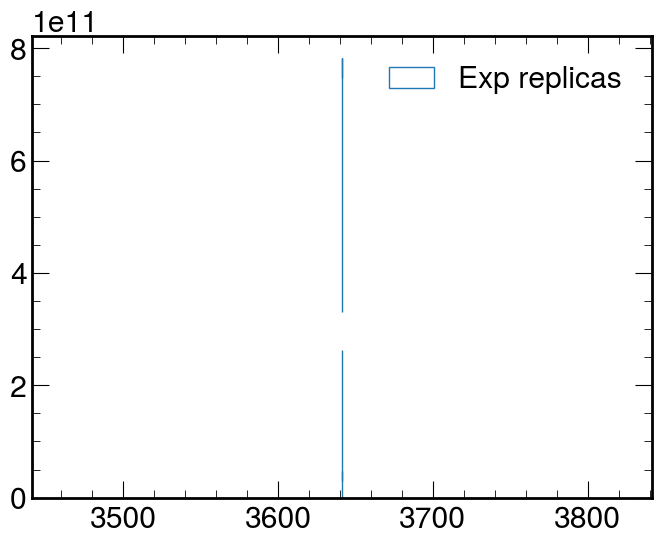

In [153]:
print(exp_replicas_array)

fig = plt.figure(figsize=(8,6))
h, b, _ = plt.hist(exp_replicas_array, color='tab:blue', density=True, histtype='step', lw=2, label='Exp replicas')
# h, b, _ = plt.hist(hist_sampling[:,i], bins=np.arange(min(hist_poisson[:,i]), max(hist_poisson[:,i])), color='tab:red', density=True, histtype='step', lw=2, label='Sampling toy')
# h, b, _ = plt.hist(hist_sampling_AT[:,i], bins=np.arange(min(hist_poisson[:,i]), max(hist_poisson[:,i])), color='tab:green', density=True, histtype='step', lw=2, label='Sampling toy (AT)')
# print(hist_sampling[:,i])
# print(b)
x = np.arange(b[0],b[len(b)-1])
x = np.round(x).astype(int)
pmf = poisson.pmf(x, exp)
print("b:", b)
print("x:", x)
print("exp:", exp)
print("pmf:", pmf)

# scaled_pmf=pmf
# spl = CubicSpline(x, scaled_pmf) ## We are using a spline to represent the Poisson just for visualisation, a Poisson distribution is defined only for discrete values
# x = np.linspace(b[0],b[len(b)-1],1000)
# plt.plot(x, spl(x), color='black', label='Poiss('+str(round(exp,2))+')')
plt.legend()
plt.show()

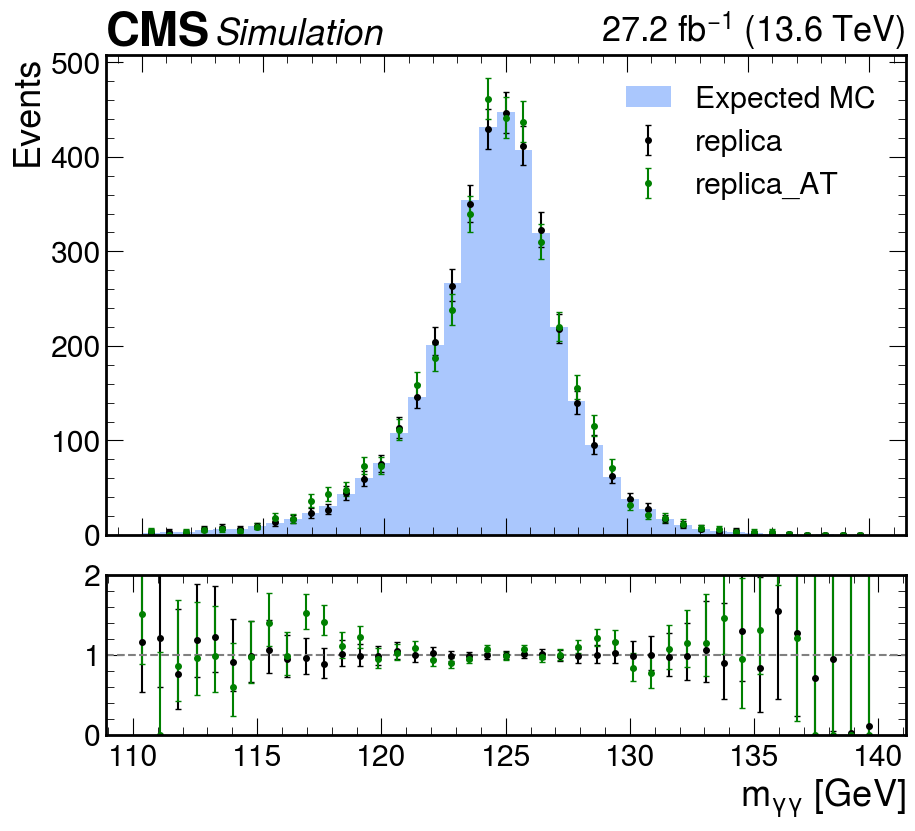

In [91]:
nbins = 41
nreplica = 5 ## Choose a replica to plot

fig = plt.figure(figsize=(10,8))
frame1 = fig.add_axes((.1, .35, .8, .6))
hep.cms.label('', data=False, lumi=27.2, com=13.6)
hist_exp, _, _ = plt.hist(
    df["mass"], 
    bins=nbins, 
    range=[110,140], 
    weights=df["weight_norm"]* 58.97 * 0.2270/100 * 1000 * 27.2, # (Weight / sum of weights) * XS * BR (H->gg) * lumi of 58.97 in fb-1 (want in pb-1?)
    label="Expected MC",
    alpha=0.5
)
# hist, bins= np.histogram(replicas[nreplica], range=[110,140], bins=nbins)
replica_weights = replicas[nreplica]["weight_norm"] * 58.97 * 0.2270/100 * 1000 * 27.2 * (1 / replicas[nreplica]["prob"].sum())
replica_weights_test = replicas[nreplica]["weight"] * 58.97 * 0.2270/100 * 1000 * 27.2 * (sum(df["weight_norm"]) / sum(replicas[nreplica]["weight_norm"])) * (1 / sum_weight_central)
hist, bins= np.histogram(replicas[nreplica]["mass"], range=[110,140], bins=nbins, weights=replica_weights)
bin_centers = (bins[:-1] + bins[1:]) / 2
errors = poisson_interval(hist)
plt.errorbar(
    bin_centers,
    hist,
    yerr=errors,
    fmt="o",
    color="black",
    markersize=4,
    capsize=2,
    label="replica"
)
hist_AT, bins= np.histogram(replicas_AT[nreplica], range=[110,140], bins=nbins)
errors_AT = poisson_interval(hist_AT)
plt.errorbar(
    bin_centers,
    hist_AT,
    yerr=errors_AT,
    fmt="o",
    color="green",
    markersize=4,
    capsize=2,
    label="replica_AT"
)

plt.ylabel("Events")
plt.legend()

frame1.set_xticklabels([])
frame2 = fig.add_axes((.1,.1,.8,.2))

ratio = hist / hist_exp
err_ratio = errors / hist_exp

plt.errorbar(
    bin_centers,
    ratio,
    yerr=err_ratio,
    fmt="o",
    color="black",
    markersize=4,
    capsize=2,
    label="replica"
)


ratio_AT = hist_AT / hist_exp
err_ratio_AT = errors / hist_exp

plt.errorbar(
    bin_centers,
    ratio_AT,
    yerr=err_ratio_AT,
    fmt="o",
    color="green",
    markersize=4,
    capsize=2,
    label="replica"
)

plt.axhline(y=1, color='grey', ls = '--')

plt.ylim([0,2])


plt.xlabel(r"$m_{\gamma\gamma}~[GeV]$")
plt.show()

In [92]:
print(replica_weights)
print(replica_weights_test)
print(sum(df["weight_norm"]) / sum_weight_central)

53549    0.069292
35424    0.074046
4462     0.008252
43277    0.008434
47235    0.066982
           ...   
51493    0.060451
17508    0.062763
65223    0.096378
2118     0.010178
3364     0.060057
Name: weight_norm, Length: 75749, dtype: float64
53549    0.069292
35424    0.074046
4462     0.008252
43277    0.008434
47235    0.066982
           ...   
51493    0.060451
17508    0.062763
65223    0.096378
2118     0.010178
3364     0.060057
Name: weight, Length: 75749, dtype: float64
4.28462806723036e-07


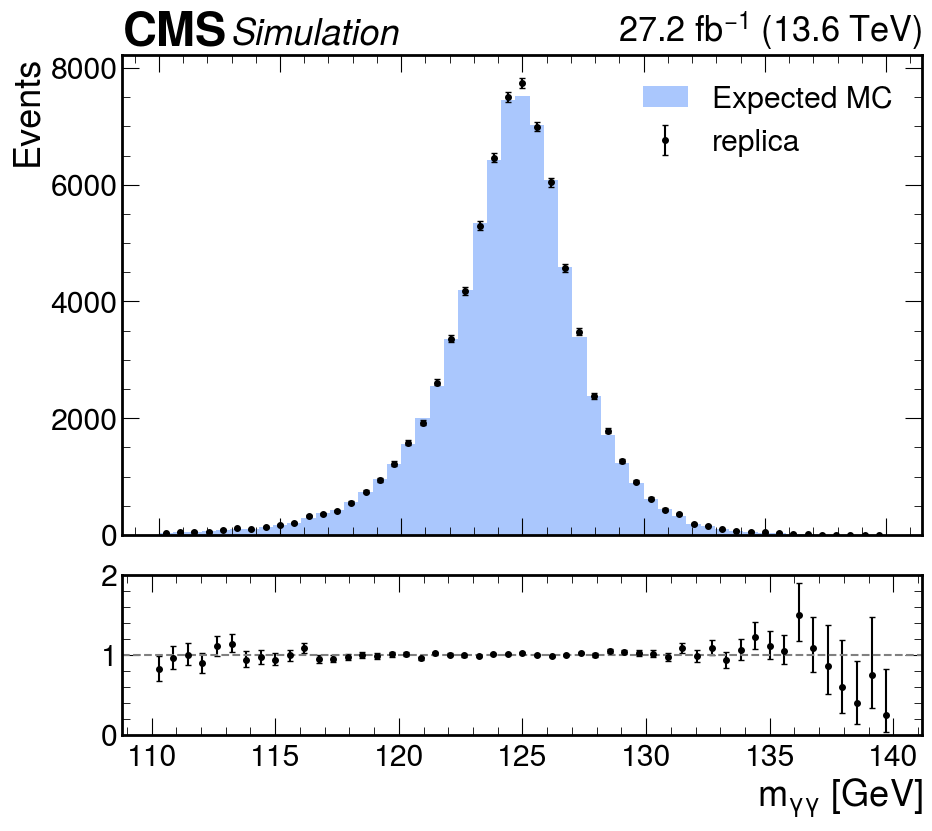

In [95]:
nbins = 51
nreplica = 1555## Choose a replica to plot

fig = plt.figure(figsize=(10,8))
frame1 = fig.add_axes((.1, .35, .8, .6))
hep.cms.label('', data=False, lumi=27.2, com=13.6)

hist_exp, _, _ = plt.hist(
    df["mass"], 
    bins=nbins, 
    range=[110,140], 
    label="Expected MC",
    alpha=0.5
)

hist, bins= np.histogram(replicas[nreplica]["mass"], range=[110,140], bins=nbins)
bin_centers = (bins[:-1] + bins[1:]) / 2
errors = poisson_interval(hist)
plt.errorbar(
    bin_centers,
    hist,
    yerr=errors,
    fmt="o",
    color="black",
    markersize=4,
    capsize=2,
    label="replica"
)

plt.ylabel("Events")
plt.legend()

frame1.set_xticklabels([])
frame2 = fig.add_axes((.1,.1,.8,.2))

ratio = hist / hist_exp
err_ratio = errors / hist_exp

plt.errorbar(
    bin_centers,
    ratio,
    yerr=err_ratio,
    fmt="o",
    color="black",
    markersize=4,
    capsize=2,
    label="replica"
)


plt.axhline(y=1, color='grey', ls = '--')

plt.ylim([0,2])


plt.xlabel(r"$m_{\gamma\gamma}~[GeV]$")
plt.show()

# Validation
Here I want to compare the distributions of events in each bin for all the replicas and compare it from the distribution of events from a "standard" toy MC.

Usually, in toy MC generation, for each bin, we extract a Poisson number (with mean equal to the expected) that represents the number of events in that bin

In [96]:
# hist_sampling_AT = np.array([np.histogram(replicas_AT[i], range=[110,140], bins=nbins)[0] for i in range(n_replicas)]) # Sampling toy
# hist_sampling = np.array([np.histogram(replicas[i]["mass"], range=[110,140], bins=nbins, weights=replicas[i]["weight"] * 58.97 * 0.2270/100 * 1000 * 27.2 * (sum(df["weight_norm"]) / sum(replicas[i]["weight_norm"])) * (1 / sum_weight_central))[0] for i in range(n_replicas)]) # Sampling toy
hist_sampling = np.array([np.histogram(replicas[i]["mass"], range=[110,140], bins=nbins)[0] for i in range(n_replicas)]) # Sampling toy
hist_poisson  = poisson.rvs(mu=hist_exp, size=(n_replicas, len(hist_exp))) # Poisson toy
hist_sampling

array([[41, 62, 54, ...,  7,  3,  1],
       [45, 52, 69, ...,  4,  2,  4],
       [47, 51, 64, ...,  8,  4,  3],
       ...,
       [38, 56, 72, ...,  6,  3,  0],
       [36, 53, 75, ...,  5,  4,  2],
       [28, 57, 72, ...,  9,  2,  4]])

In [97]:
# print("hist_sampling_AT", hist_sampling_AT)
# print("hist_sampling", hist_sampling)
# print("hist_poisson", hist_poisson)
# print(replicas_AT[0])
# print(replicas[0])
print(np.mean(hist_poisson[:, 34]))
print(np.mean(hist_sampling[:, 34]))

610.4404
610.0687


Bin  0
np.mean sampling  39.0349
np.mean poisson  38.9267


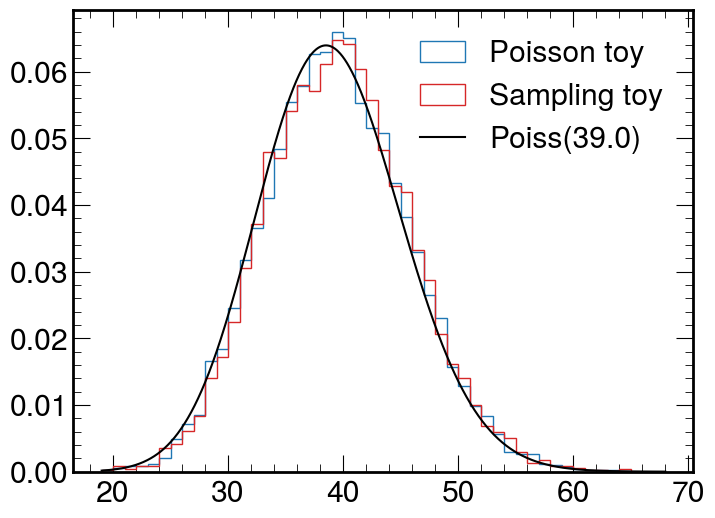

Bin  1
np.mean sampling  52.939
np.mean poisson  52.9253


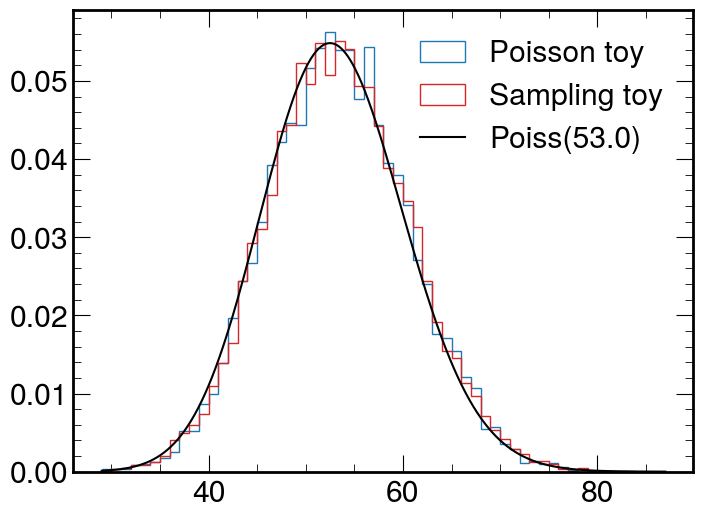

Bin  2
np.mean sampling  59.9616
np.mean poisson  60.0892


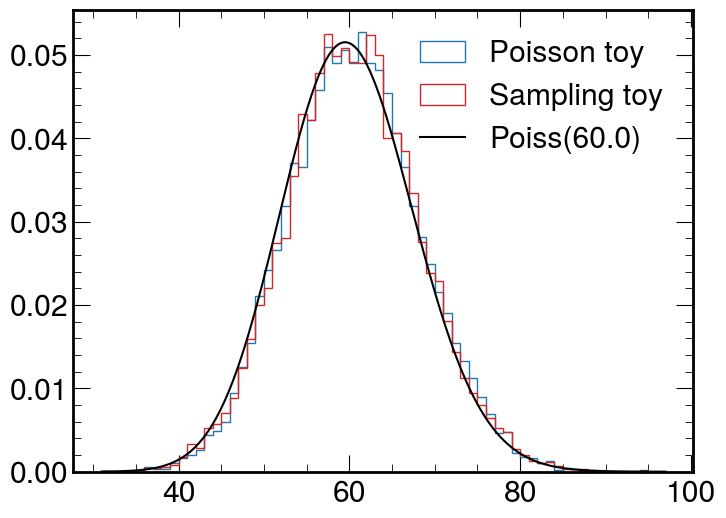

Bin  3
np.mean sampling  67.0335
np.mean poisson  66.8154


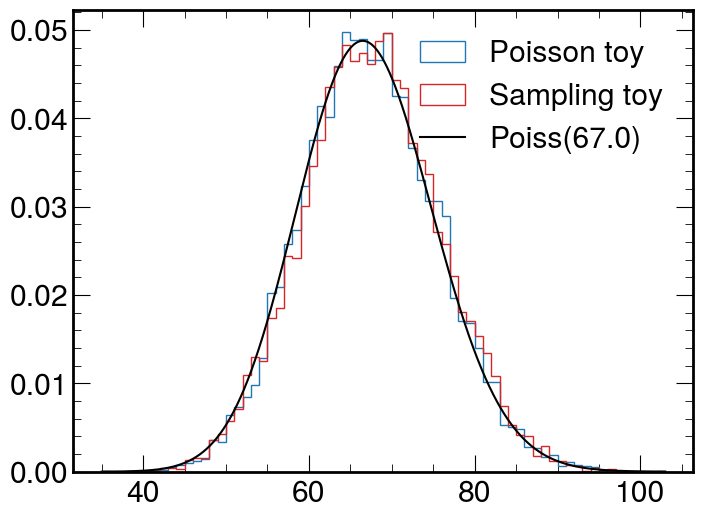

Bin  4
np.mean sampling  81.8133
np.mean poisson  81.9943


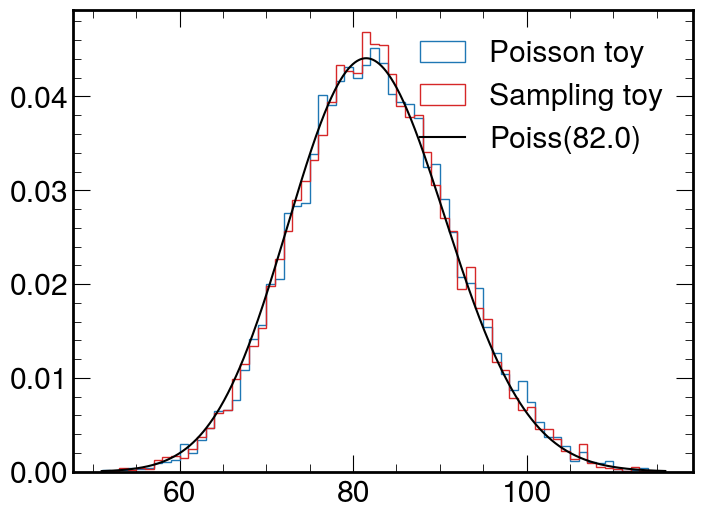

Bin  5
np.mean sampling  98.1225
np.mean poisson  97.9389


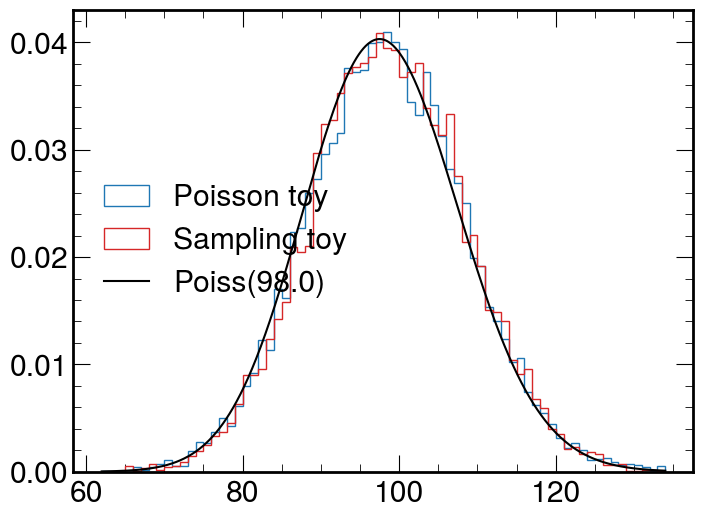

Bin  6
np.mean sampling  101.9213
np.mean poisson  102.0682


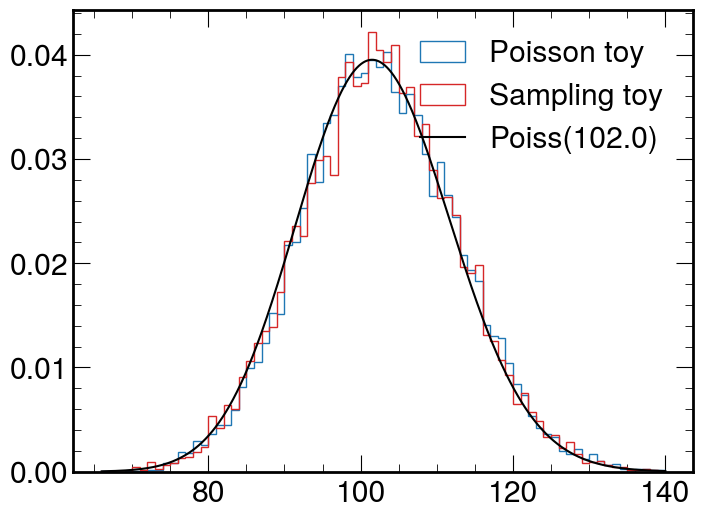

Bin  7
np.mean sampling  142.0923
np.mean poisson  141.9563


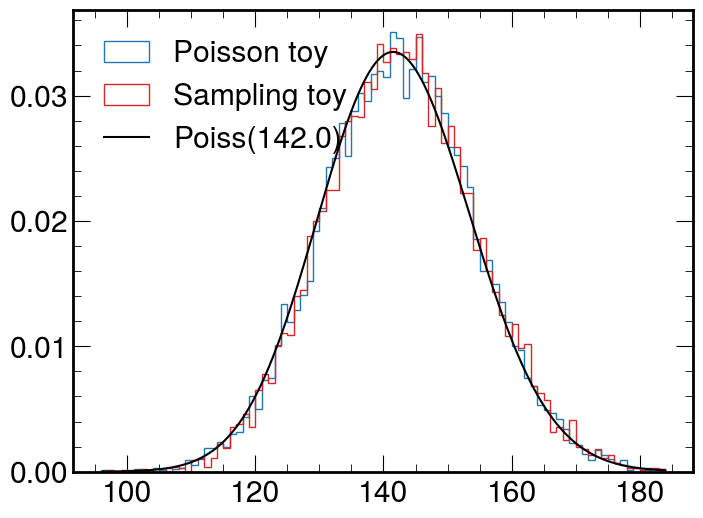

Bin  8
np.mean sampling  176.8123
np.mean poisson  176.9468


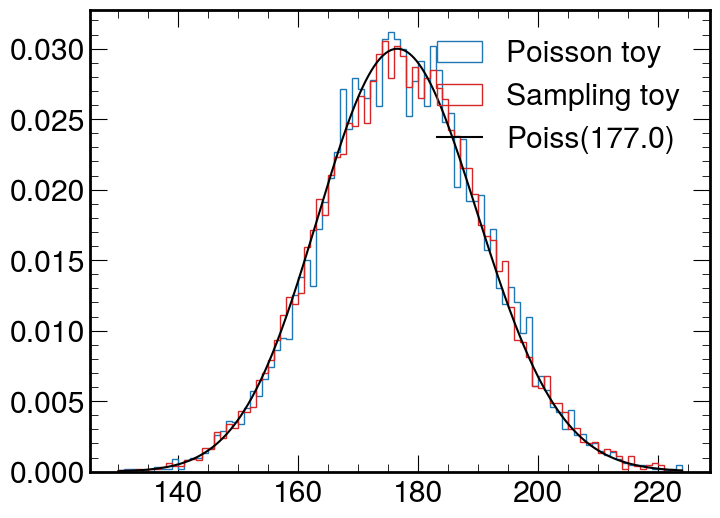

Bin  9
np.mean sampling  210.8558
np.mean poisson  210.8124


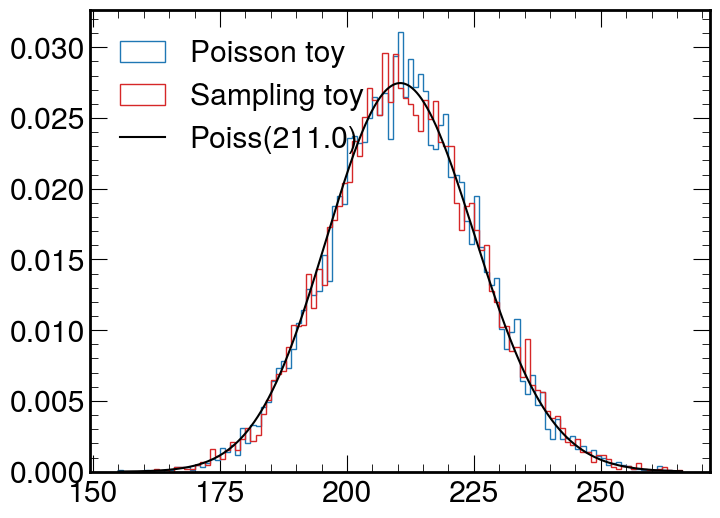

Bin  10
np.mean sampling  298.0825
np.mean poisson  297.9536


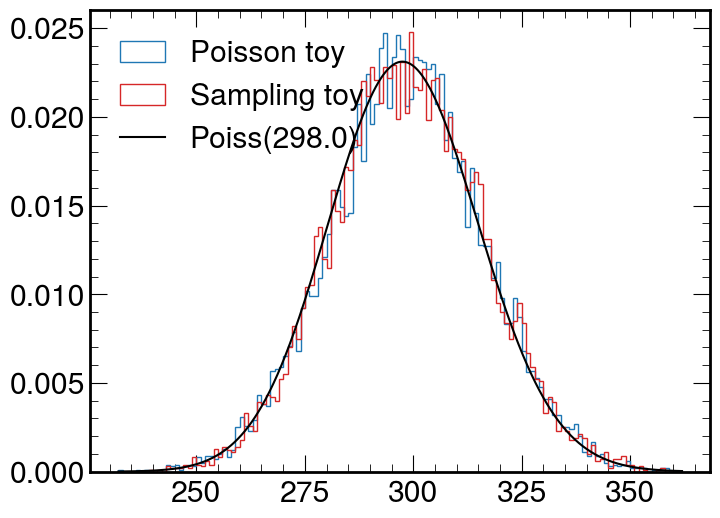

Bin  11
np.mean sampling  376.7784
np.mean poisson  377.1301


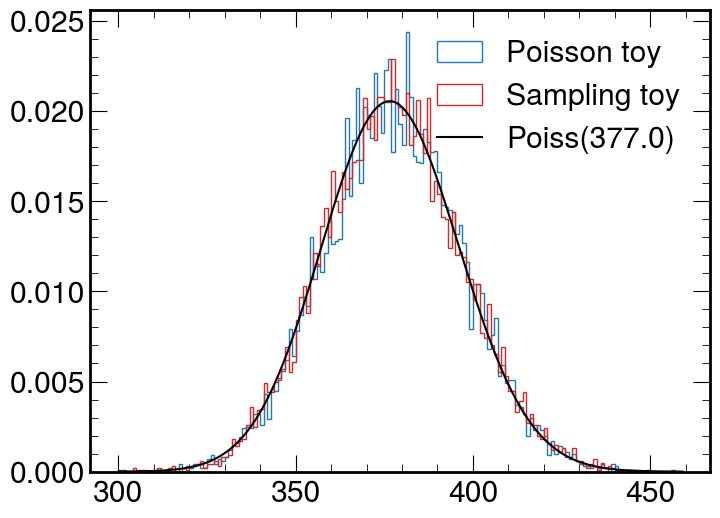

Bin  12
np.mean sampling  430.0009
np.mean poisson  429.9649


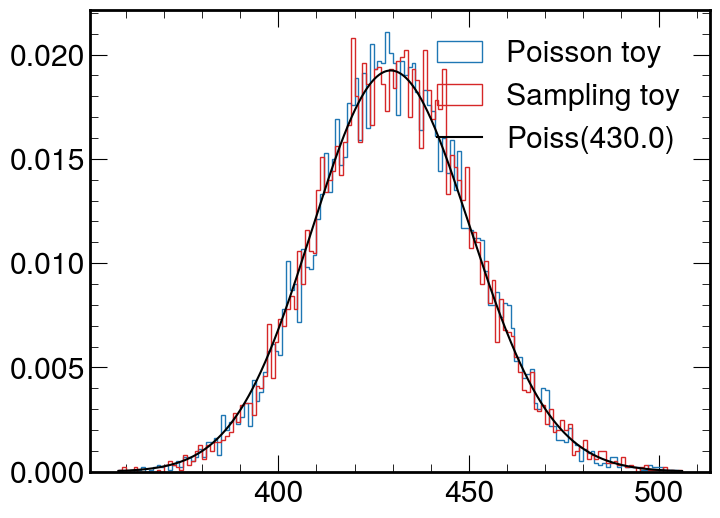

Bin  13
np.mean sampling  565.1853
np.mean poisson  565.1045


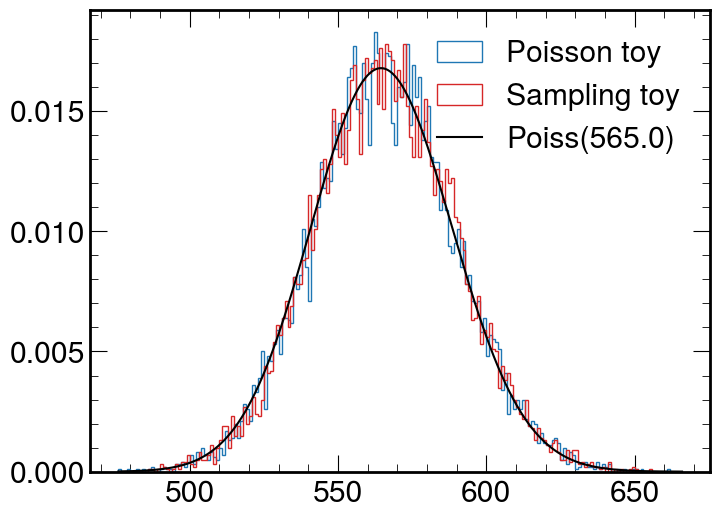

Bin  14
np.mean sampling  743.012
np.mean poisson  743.5178


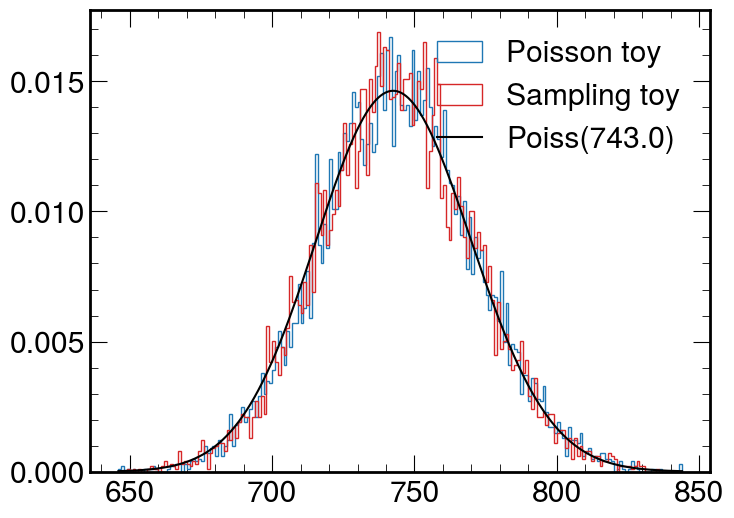

Bin  15
np.mean sampling  956.4719
np.mean poisson  956.668


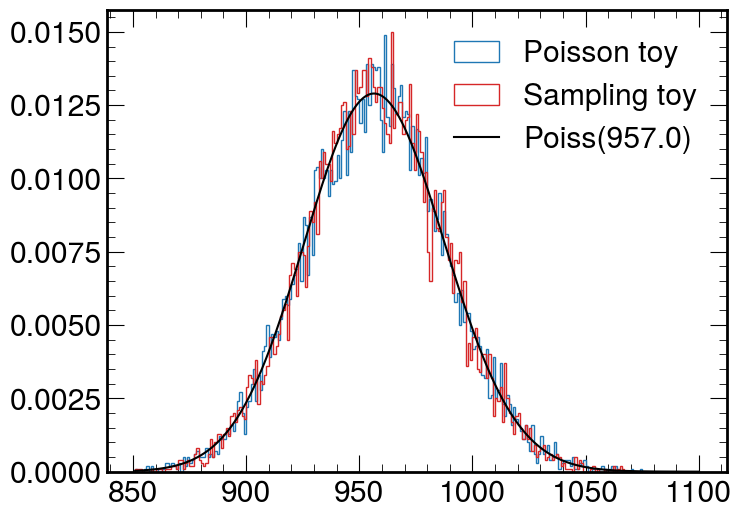

Bin  16
np.mean sampling  1214.7935
np.mean poisson  1215.0827


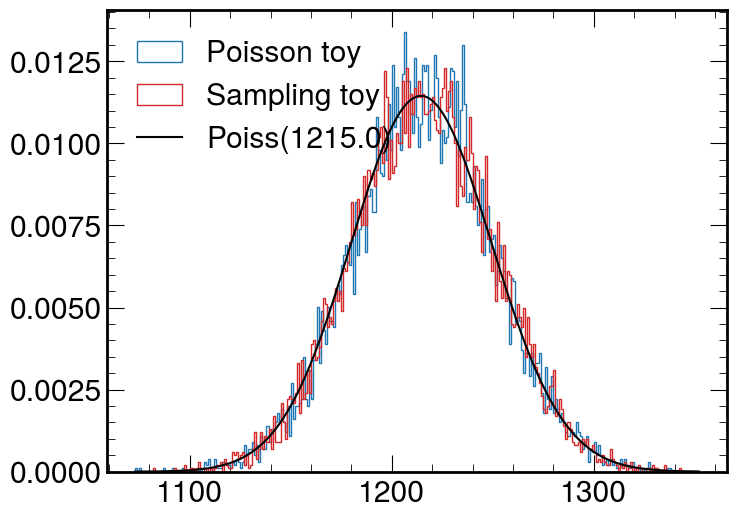

Bin  17
np.mean sampling  1560.1964
np.mean poisson  1560.0037


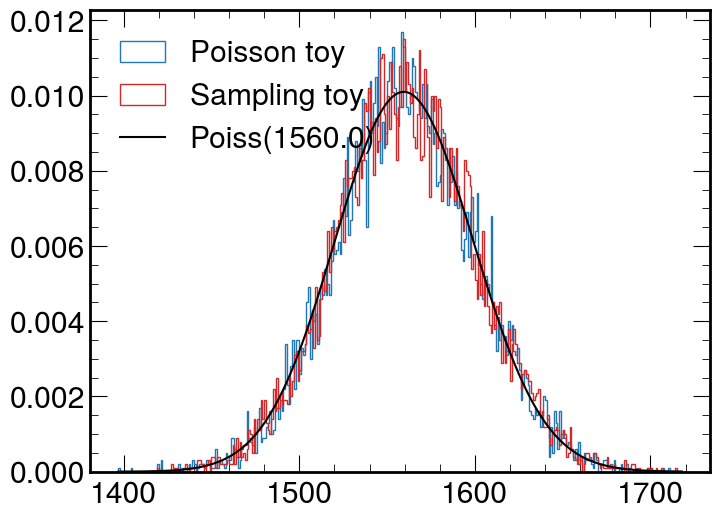

Bin  18
np.mean sampling  2011.3262
np.mean poisson  2012.0135


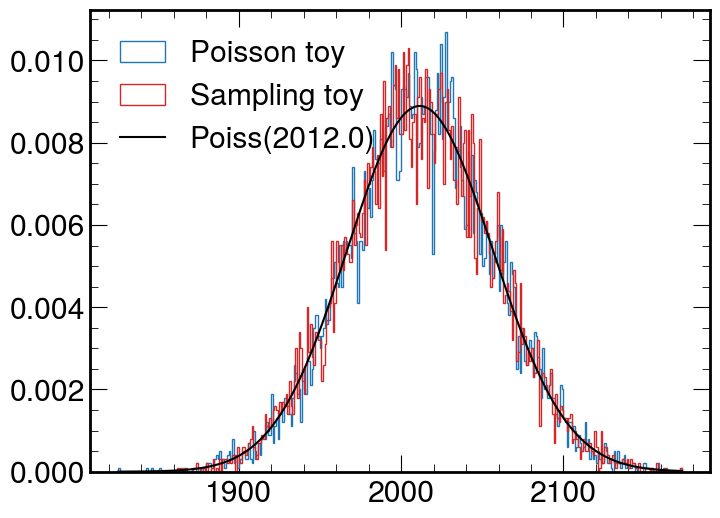

Bin  19
np.mean sampling  2554.3716
np.mean poisson  2553.7887


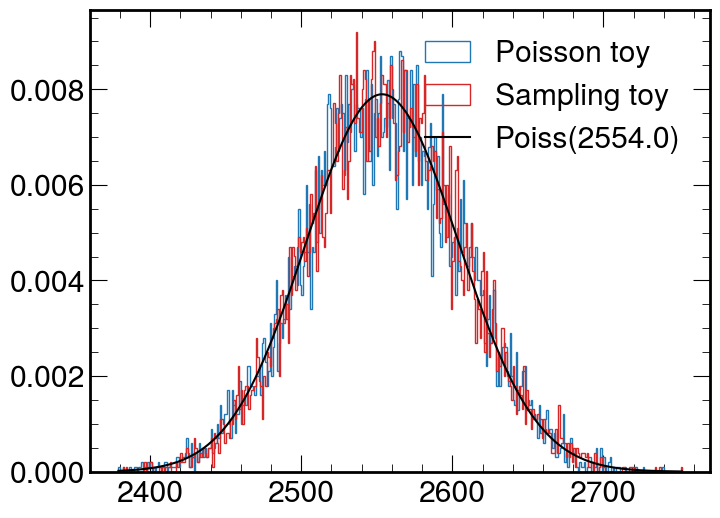

Bin  20
np.mean sampling  3354.3578
np.mean poisson  3355.6185


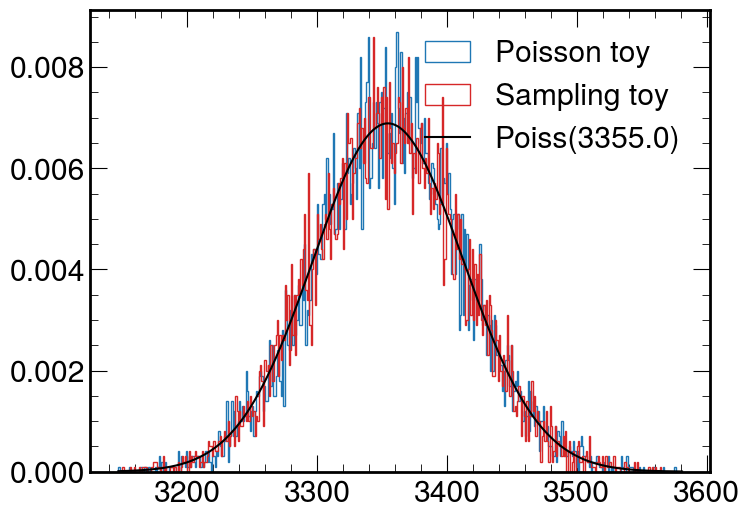

Bin  21
np.mean sampling  4197.226
np.mean poisson  4198.3381


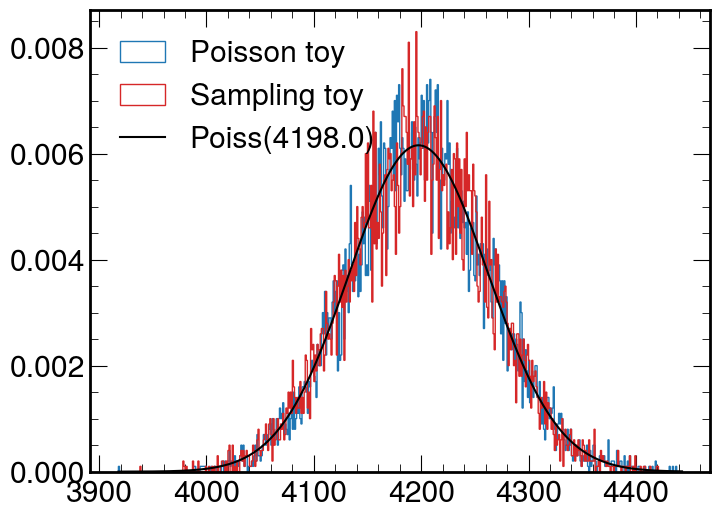

Bin  22
np.mean sampling  5338.5179
np.mean poisson  5339.1784


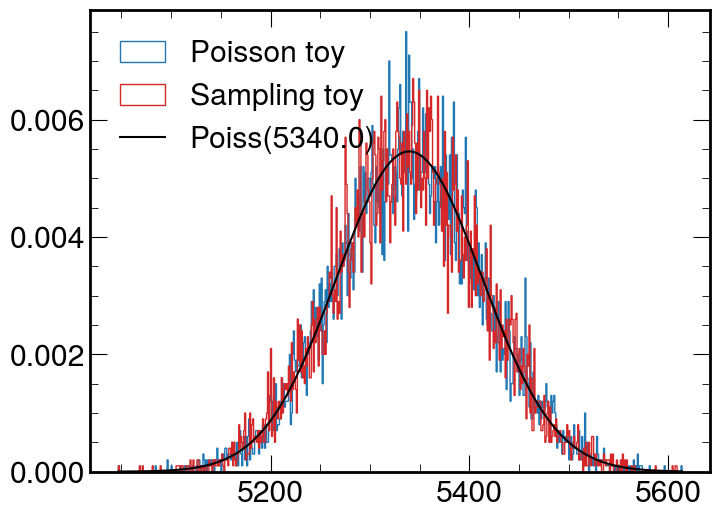

Bin  23
np.mean sampling  6416.1387
np.mean poisson  6415.7883


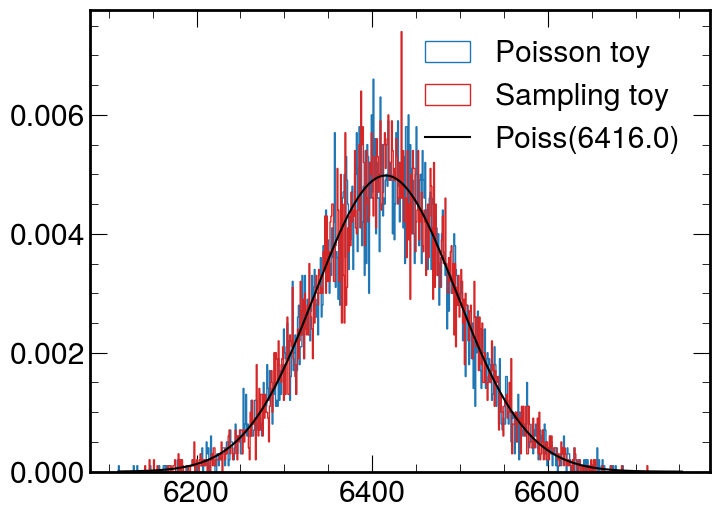

Bin  24
np.mean sampling  7450.282
np.mean poisson  7449.6657


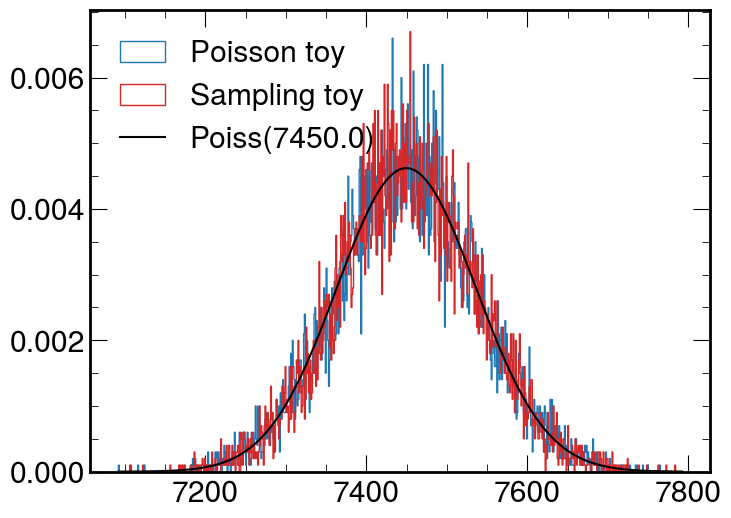

Bin  25
np.mean sampling  7517.5818
np.mean poisson  7517.5648


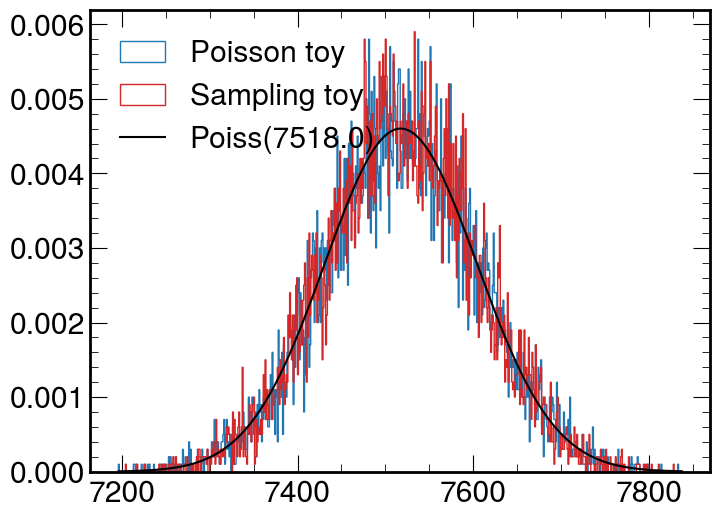

Bin  26
np.mean sampling  7031.6946
np.mean poisson  7031.243


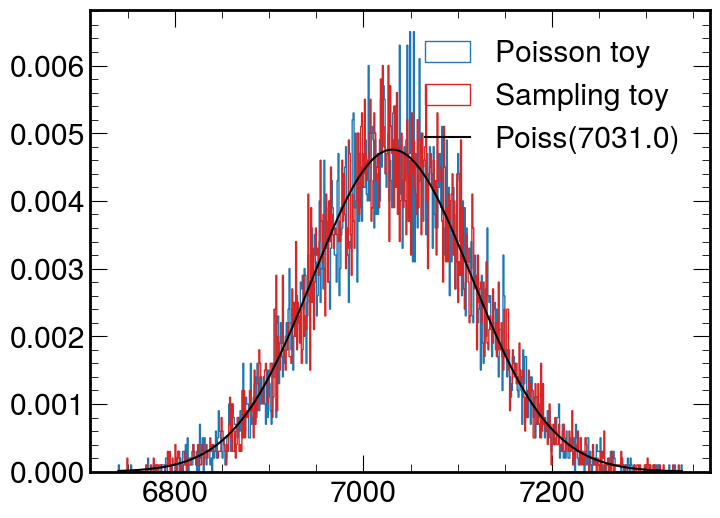

Bin  27
np.mean sampling  6077.5203
np.mean poisson  6078.9016


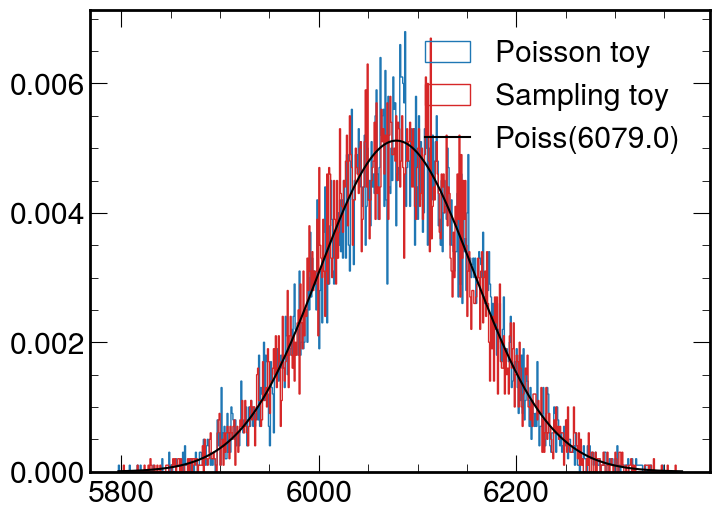

Bin  28
np.mean sampling  4595.6775
np.mean poisson  4594.2961


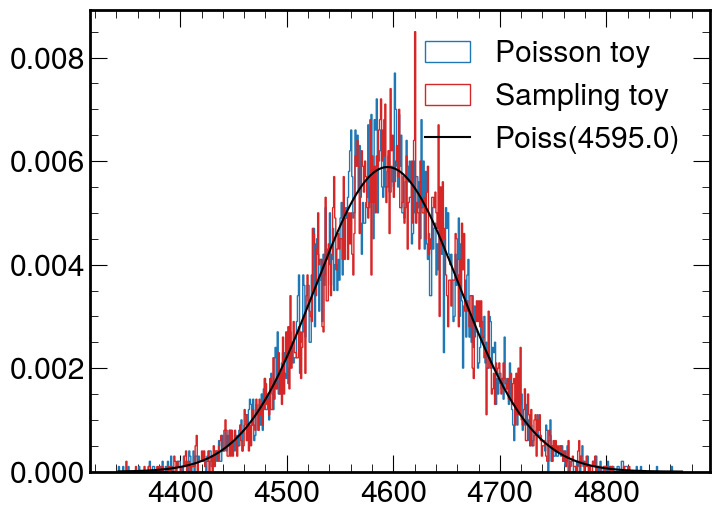

Bin  29
np.mean sampling  3398.0404
np.mean poisson  3399.2448


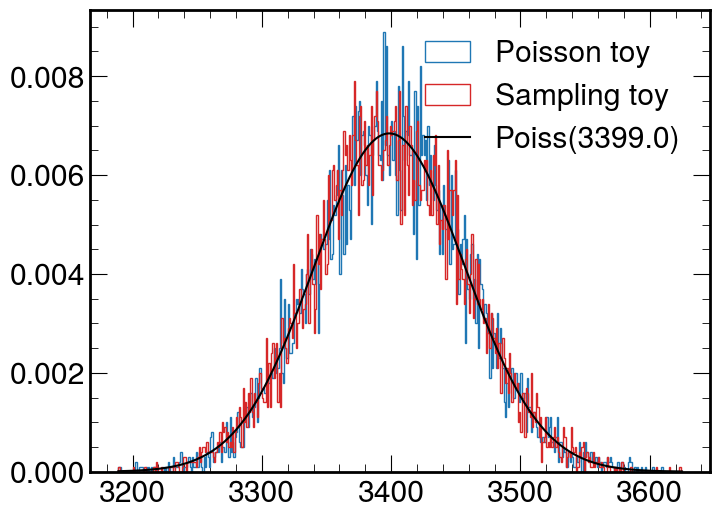

Bin  30
np.mean sampling  2382.7915
np.mean poisson  2382.6904


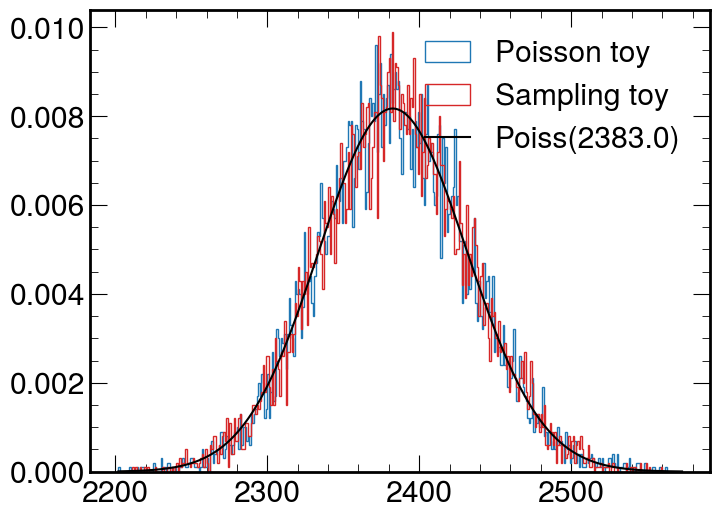

Bin  31
np.mean sampling  1707.529
np.mean poisson  1707.7697


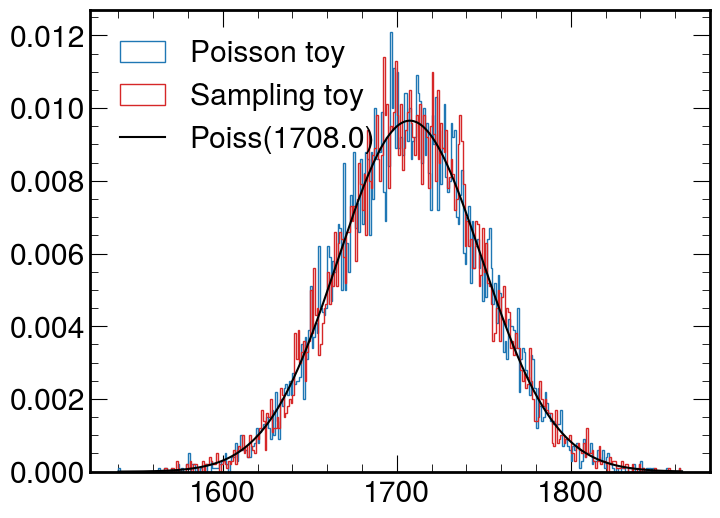

Bin  32
np.mean sampling  1226.9087
np.mean poisson  1227.3569


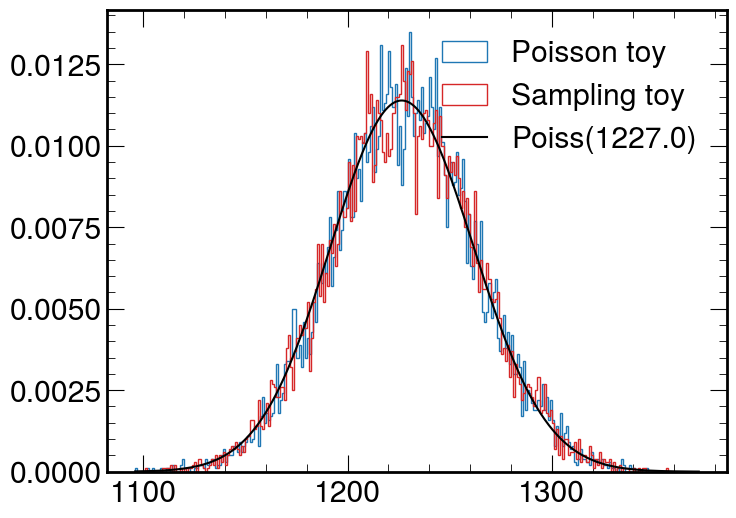

Bin  33
np.mean sampling  891.886
np.mean poisson  892.2698


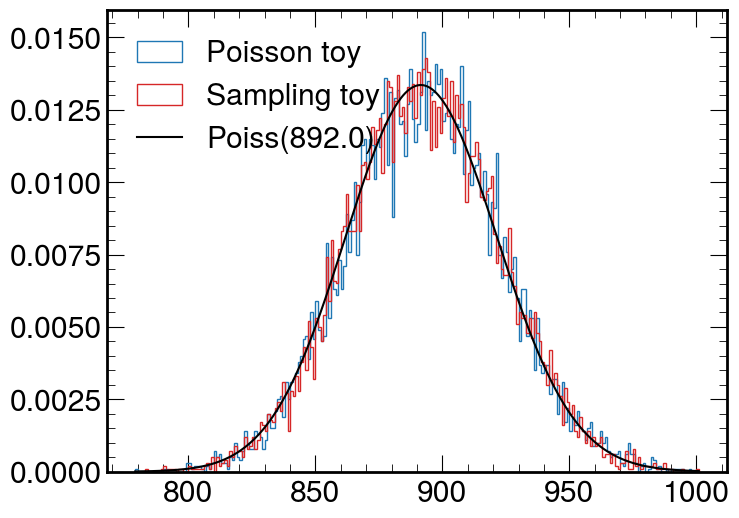

Bin  34
np.mean sampling  610.0687
np.mean poisson  610.4404


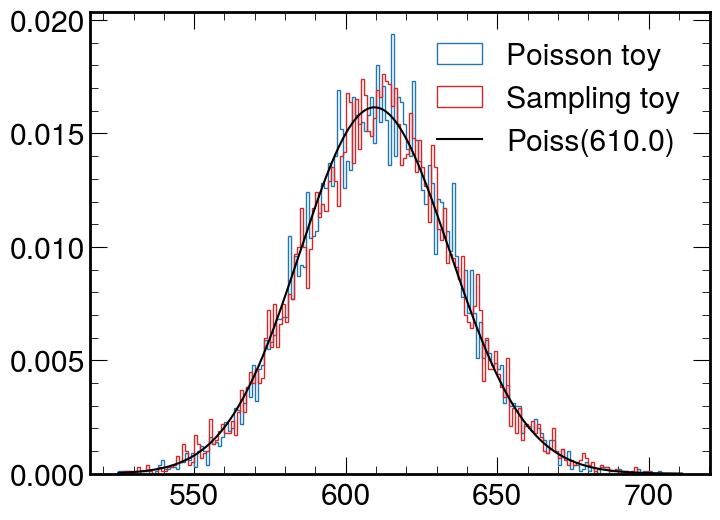

Bin  35
np.mean sampling  446.672
np.mean poisson  447.282


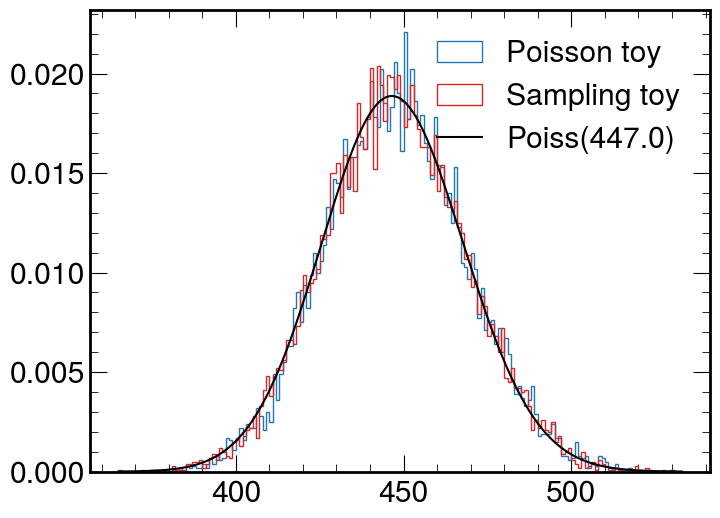

Bin  36
np.mean sampling  329.1171
np.mean poisson  328.9293


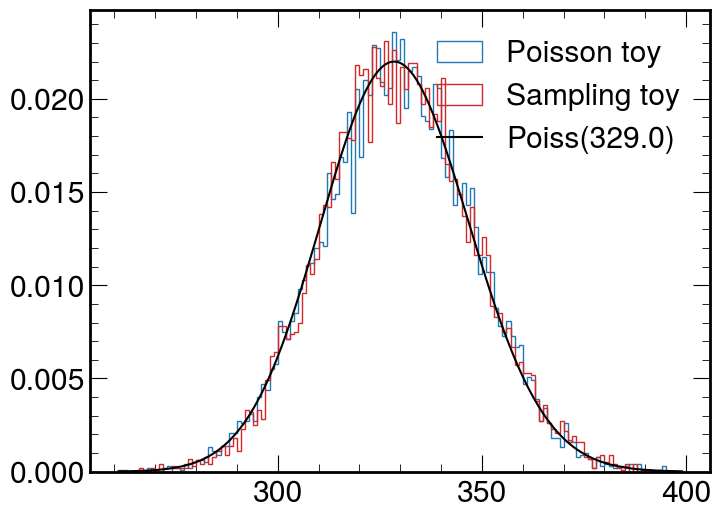

Bin  37
np.mean sampling  194.8719
np.mean poisson  195.157


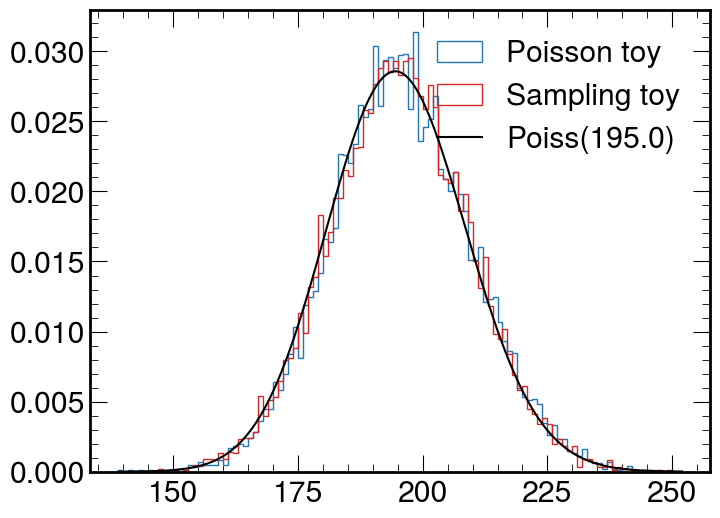

Bin  38
np.mean sampling  145.823
np.mean poisson  145.8699


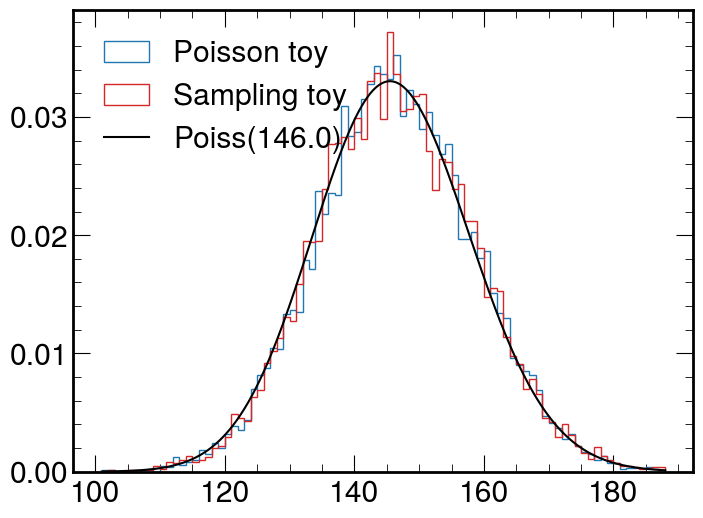

Bin  39
np.mean sampling  105.0785
np.mean poisson  105.1137


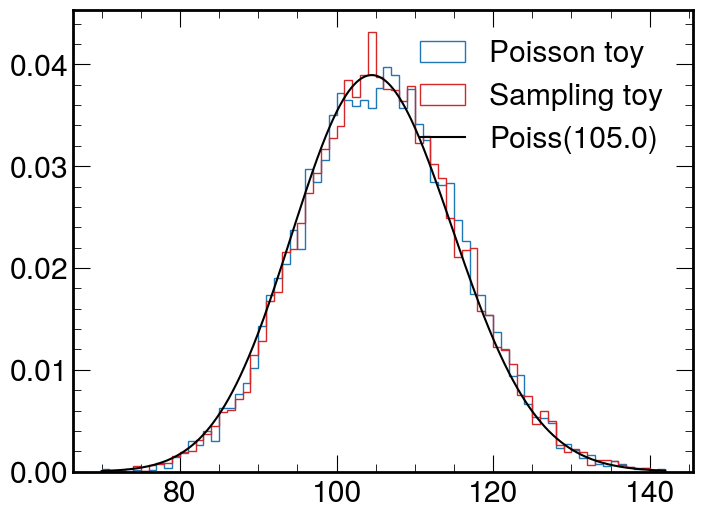

Bin  40
np.mean sampling  69.0103
np.mean poisson  68.9881


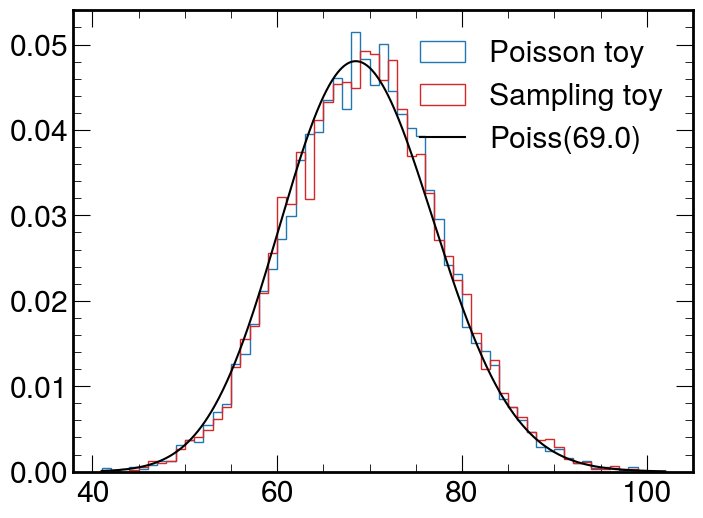

Bin  41
np.mean sampling  47.9242
np.mean poisson  47.9854


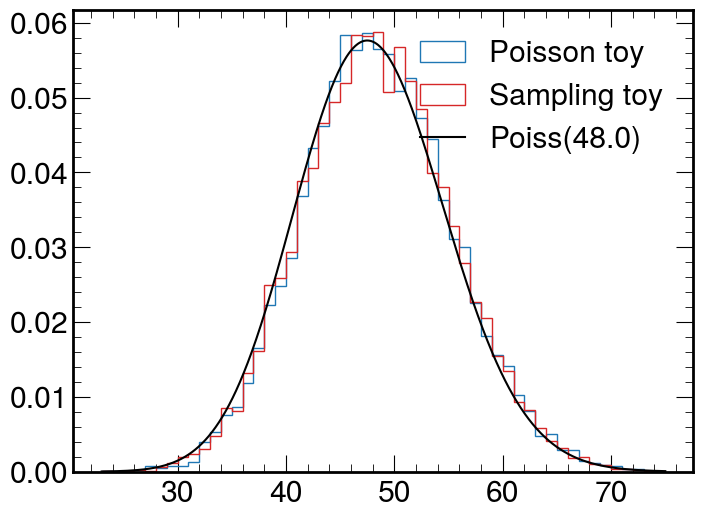

Bin  42
np.mean sampling  43.07
np.mean poisson  43.0141


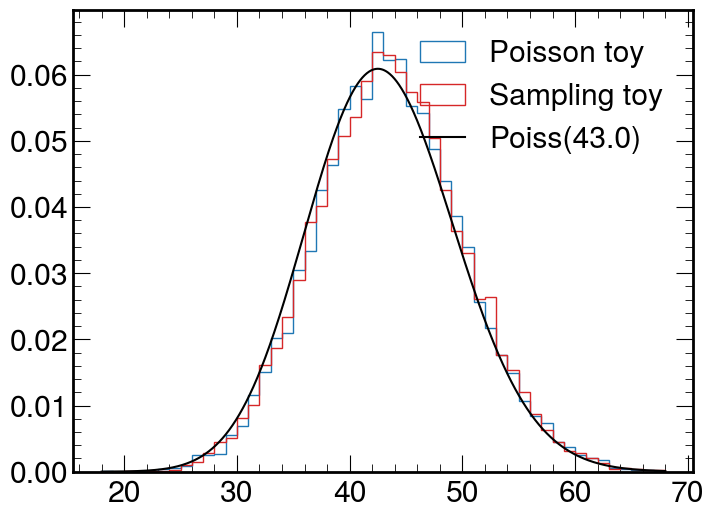

Bin  43
np.mean sampling  36.0856
np.mean poisson  35.9254


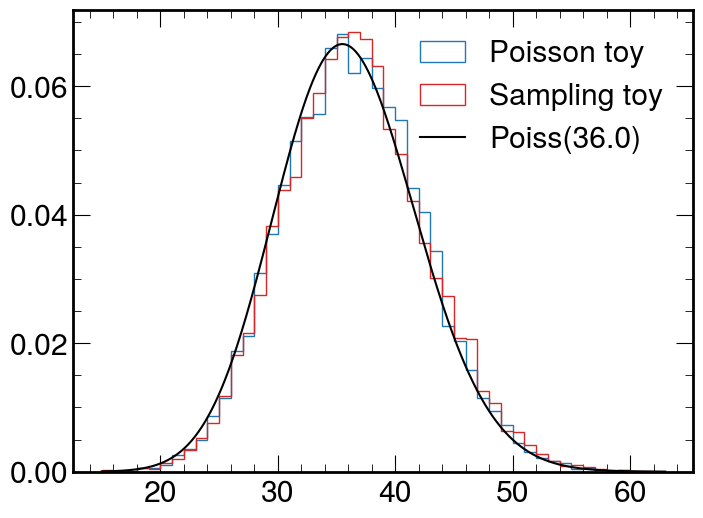

Bin  44
np.mean sampling  14.0417
np.mean poisson  14.0492


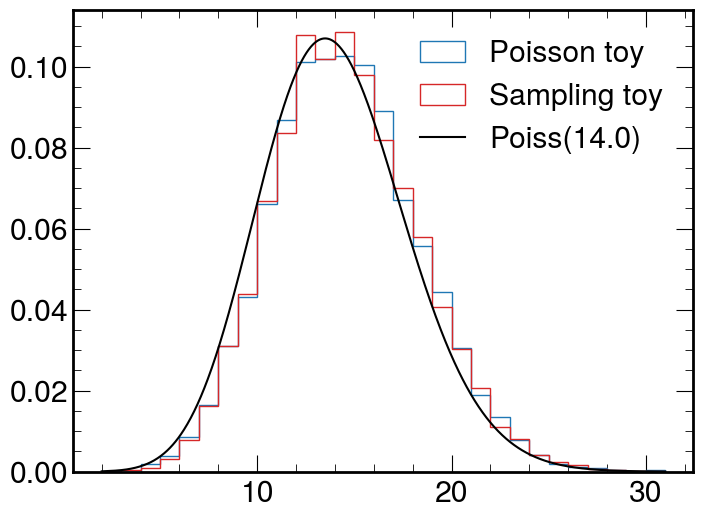

Bin  45
np.mean sampling  12.0176
np.mean poisson  11.9564


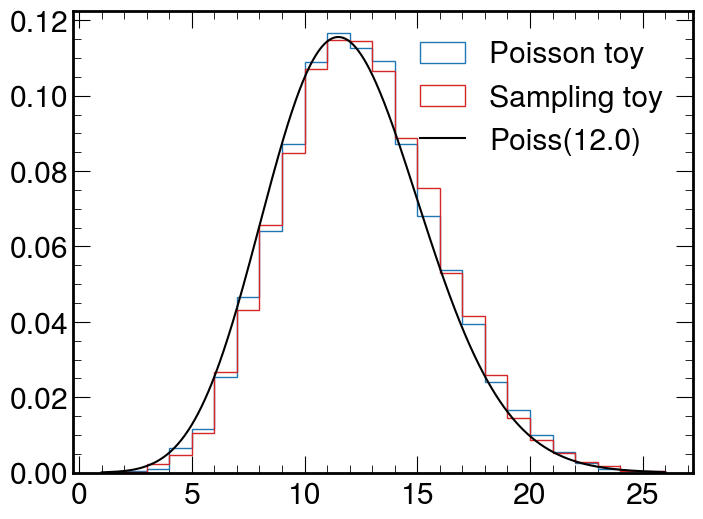

Bin  46
np.mean sampling  6.9832
np.mean poisson  6.9803


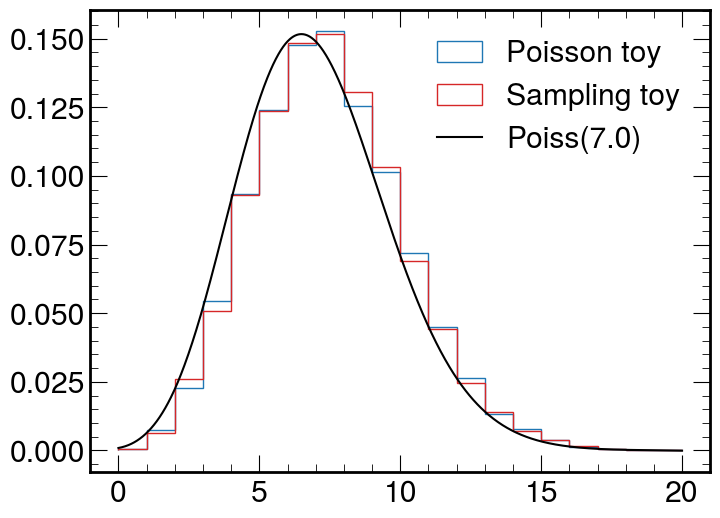

Bin  47
np.mean sampling  4.9833
np.mean poisson  4.9691


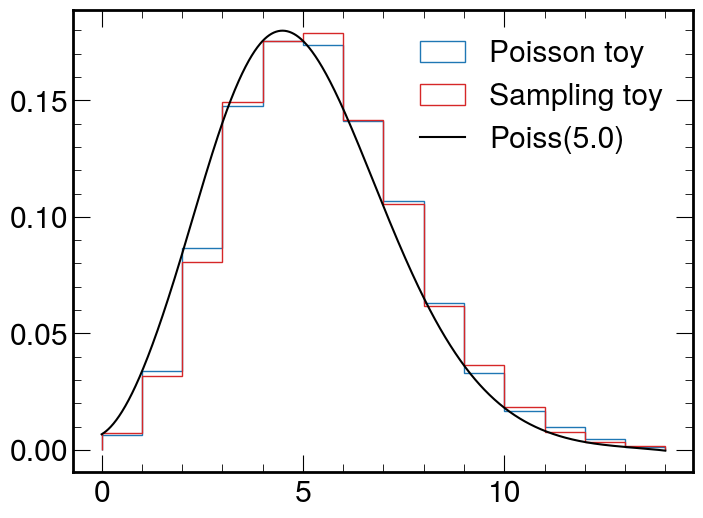

Bin  48
np.mean sampling  4.9896
np.mean poisson  4.9702


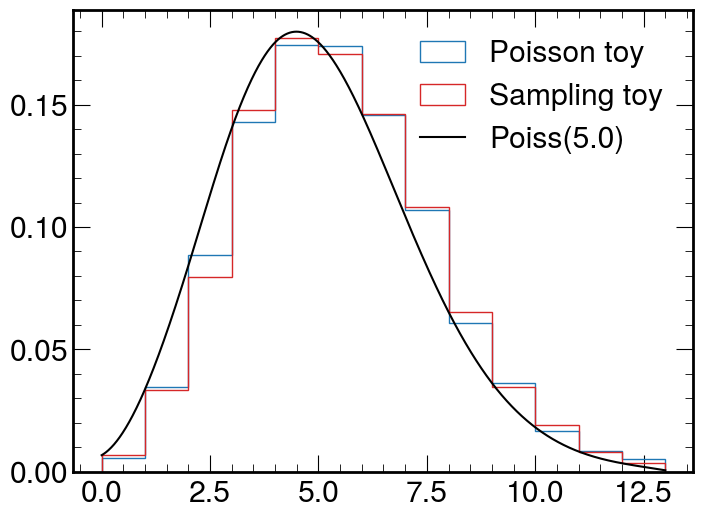

Bin  49
np.mean sampling  3.9911
np.mean poisson  4.0273


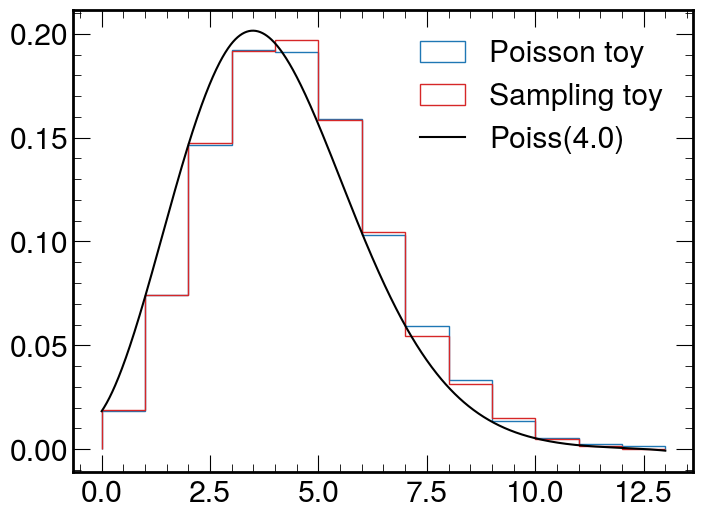

Bin  50
np.mean sampling  4.0046
np.mean poisson  3.9721


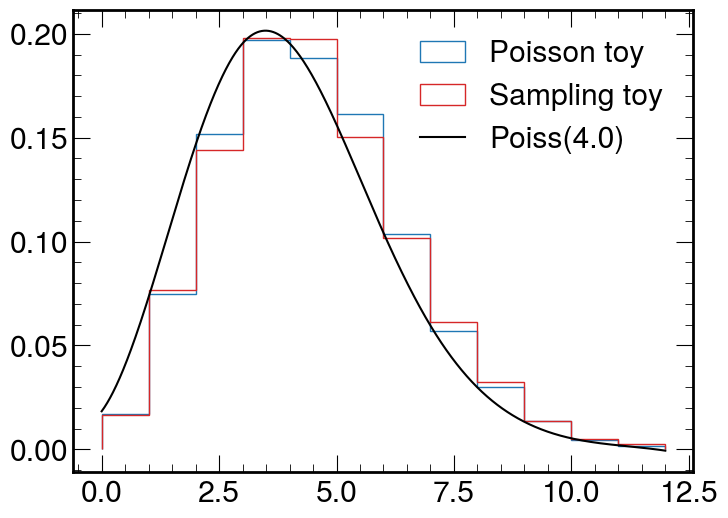

In [98]:
for i in range(nbins):
    fig = plt.figure(figsize=(8,6))
    h, b, _ = plt.hist(hist_poisson[:,i], bins=np.arange(min(hist_poisson[:,i]), max(hist_poisson[:,i])), color='tab:blue', density=True, histtype='step', lw=2, label='Poisson toy')
    h, b, _ = plt.hist(hist_sampling[:,i], bins=np.arange(min(hist_poisson[:,i]), max(hist_poisson[:,i])), color='tab:red', density=True, histtype='step', lw=2, label='Sampling toy')
    # h, b, _ = plt.hist(hist_sampling_AT[:,i], bins=np.arange(min(hist_poisson[:,i]), max(hist_poisson[:,i])), color='tab:green', density=True, histtype='step', lw=2, label='Sampling toy (AT)')
    # print(hist_sampling[:,i])
    print("Bin ", i)
    print("np.mean sampling ", np.mean(hist_sampling[:,i]))
    print("np.mean poisson ", np.mean(hist_poisson[:,i]))
    x = np.arange(b[0],b[len(b)-1])
    pmf = poisson.pmf(x, hist_exp[i])
    scaled_pmf=pmf
    spl = CubicSpline(x, scaled_pmf) ## We are using a spline to represent the Poisson just for visualisation, a Poisson distribution is defined only for discrete values
    x = np.linspace(b[0],b[len(b)-1],1000)
    plt.plot(x, spl(x), color='black', label='Poiss('+str(round(hist_exp[i],2))+')')
    plt.legend()
    plt.show()
#     break

# Validation with combine toys

In [39]:
# file = ROOT.TFile("dc_23_014/datacards/inclusive/higgsCombine.TEST.ASIMOV.GenerateOnly.mH125.38.123456.root", "READ")
file = ROOT.TFile("/t3home/niharrin/devel/work/tests/resample_mc/src_files/higgsCombine.TEST.ASIMOV.GenerateOnly.mH125.38.123456.root", "READ")
folder = file.Get("toys")
asimov = folder.Get(f"toy_asimov")
asimov = asimov.to_numpy()

In [51]:
asimov["_weight_"]

array([664.90600586, 657.48657227, 650.15631104, 642.91394043,
       635.75860596, 628.68908691, 621.70440674, 614.8034668 ,
       607.98529053, 601.24884033, 594.59313965, 588.01715088,
       581.5199585 , 575.10064697, 568.75817871, 562.49163818,
       556.30010986, 550.18261719, 544.1383667 , 538.1663208 ,
       532.26574707, 526.43566895, 520.67529297, 514.98370361,
       509.36010742, 503.80368042, 498.3135376 , 492.88894653,
       487.52905273, 482.23309326, 477.00033569, 471.82989502,
       466.72106934, 461.67312622, 456.68530273, 451.75689697,
       446.887146  , 442.07531738, 437.32073975, 432.6227417 ,
       427.9805603 , 423.39352417, 418.86105347, 414.38238525,
       409.95687866, 405.58392334, 401.26287842, 396.99307251,
       392.77389526, 388.60473633, 384.48498535, 380.4140625 ,
       376.3913269 , 372.41619873, 368.48812866, 364.60653687,
       360.77081299, 356.98046875, 353.2348938 , 349.53359985,
       345.87597656, 342.26156616, 338.6897583 , 335.16

In [48]:
file = ROOT.TFile("/t3home/niharrin/devel/work/tests/resample_mc/src_files/higgsCombine.TEST.GenerateOnly.mH125.38.123456.root", "READ")
folder = file.Get("toys")

toys = []
nreplicas_ = len(folder.GetListOfKeys())
print(n_replicas)
for toy_idx in range(int(len(folder.GetListOfKeys()))):
    toy = folder.Get(f"toy_{toy_idx+1}")
    toys.append(toy.to_numpy()["_weight_"])


file.Close()
toys = np.array(toys)

10000


In [49]:
toys[:,0]

array([720., 595., 700., ..., 666., 653., 679.])

In [50]:
hist_poisson_  = poisson.rvs(mu=asimov["_weight_"], size=(nreplicas_, len(asimov["_weight_"])))

In [52]:
np.arange(min(hist_poisson_[:,i]), max(hist_poisson_[:,i]))

array([355, 356, 357, 358, 359, 360, 361, 362, 363, 364, 365, 366, 367,
       368, 369, 370, 371, 372, 373, 374, 375, 376, 377, 378, 379, 380,
       381, 382, 383, 384, 385, 386, 387, 388, 389, 390, 391, 392, 393,
       394, 395, 396, 397, 398, 399, 400, 401, 402, 403, 404, 405, 406,
       407, 408, 409, 410, 411, 412, 413, 414, 415, 416, 417, 418, 419,
       420, 421, 422, 423, 424, 425, 426, 427, 428, 429, 430, 431, 432,
       433, 434, 435, 436, 437, 438, 439, 440, 441, 442, 443, 444, 445,
       446, 447, 448, 449, 450, 451, 452, 453, 454, 455, 456, 457, 458,
       459, 460, 461, 462, 463, 464, 465, 466, 467, 468, 469, 470, 471,
       472, 473, 474, 475, 476, 477, 478, 479, 480, 481, 482, 483, 484,
       485, 486, 487, 488, 489, 490, 491, 492, 493, 494, 495, 496, 497,
       498, 499, 500, 501, 502, 503, 504, 505, 506, 507, 508])

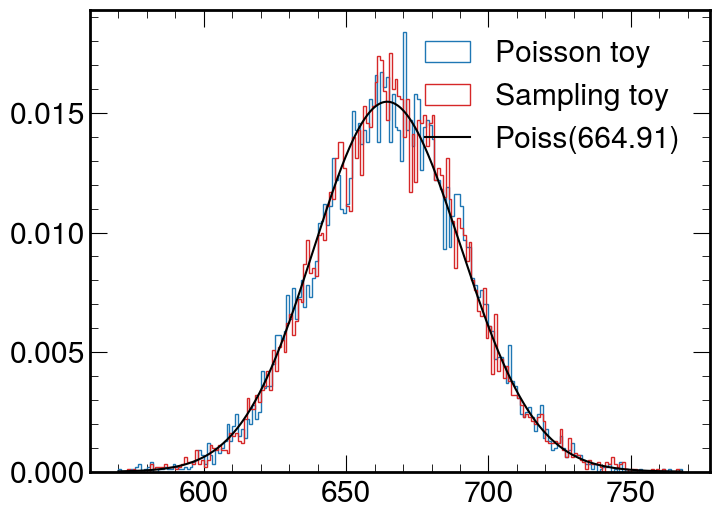

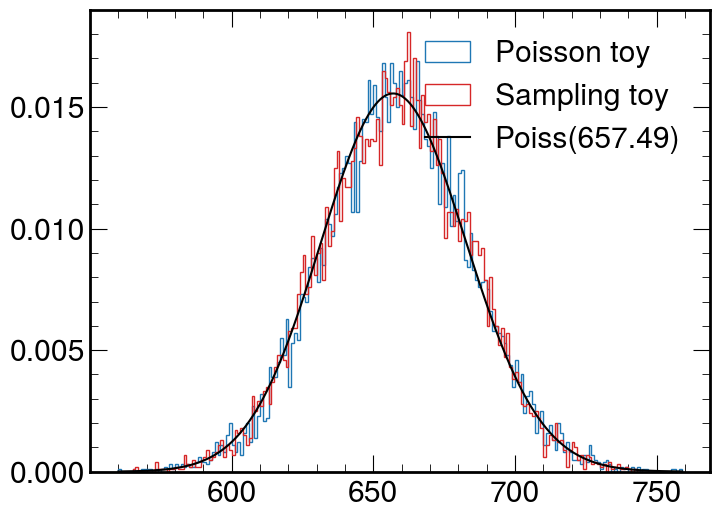

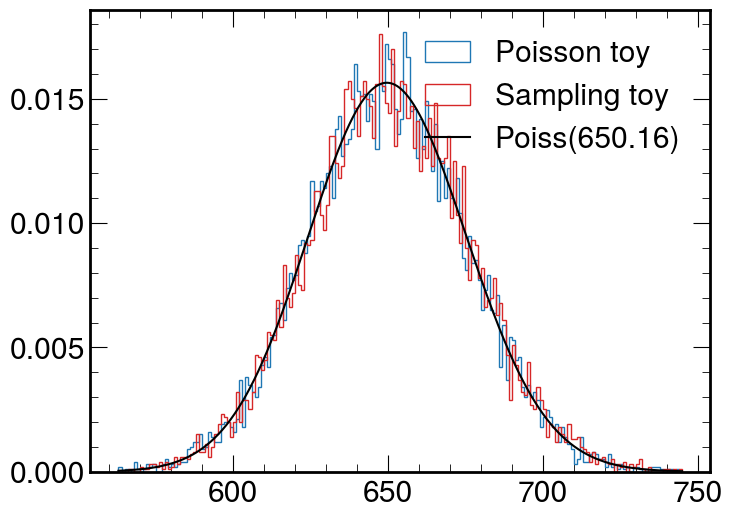

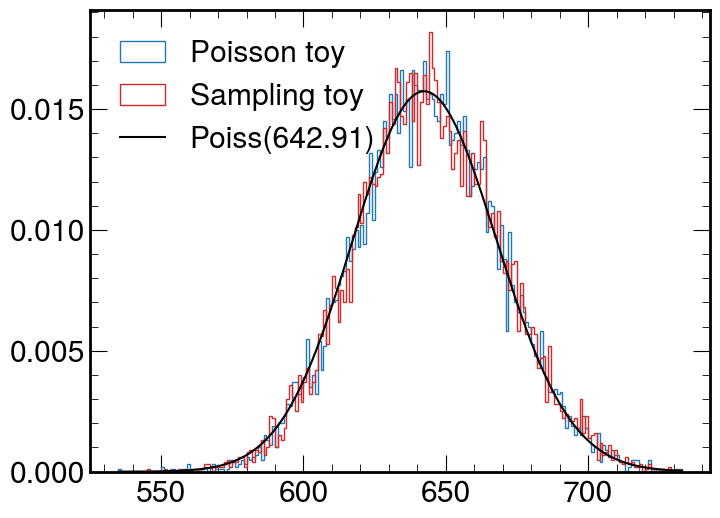

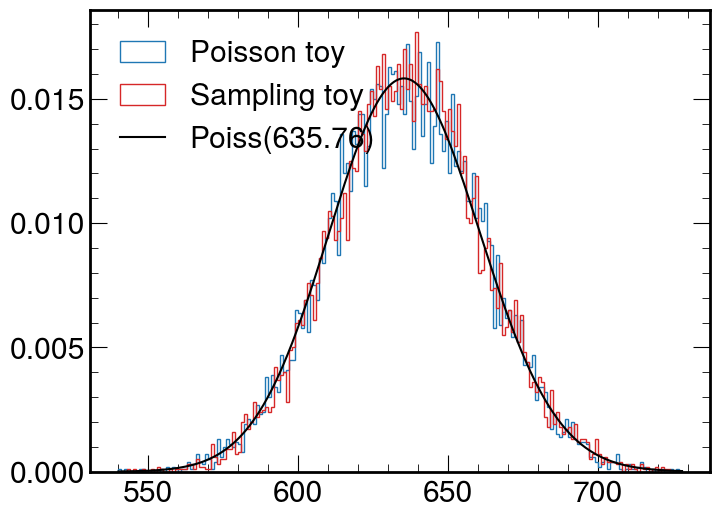

...

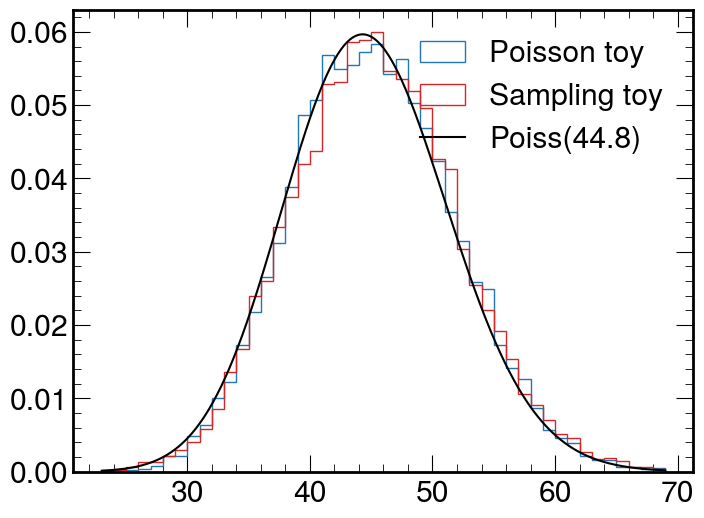

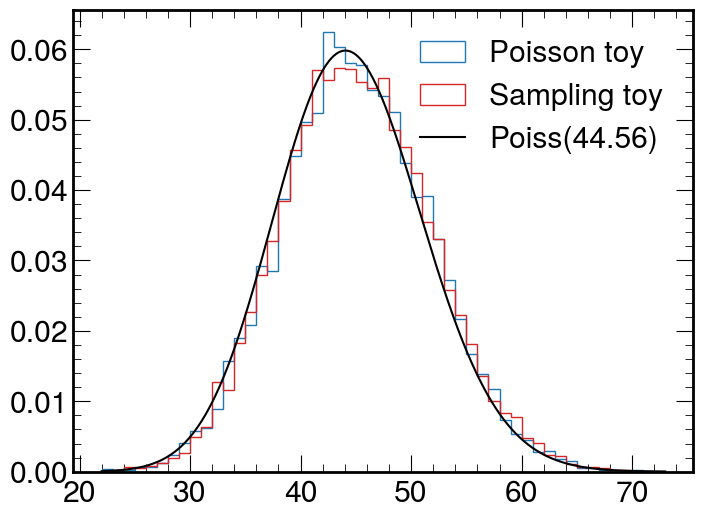

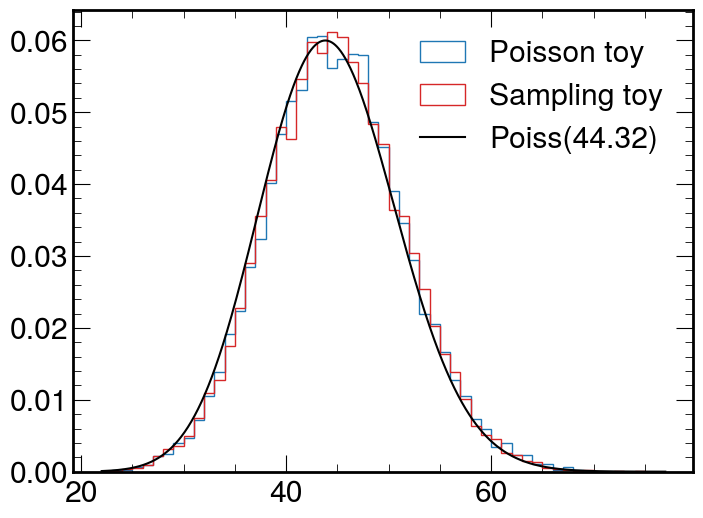

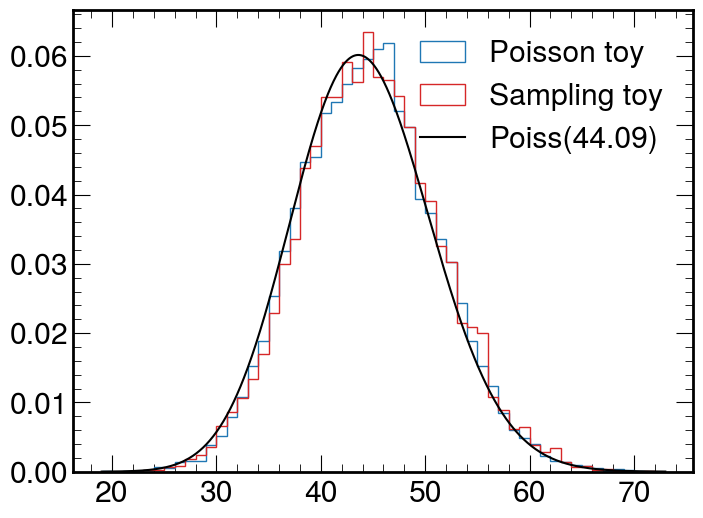

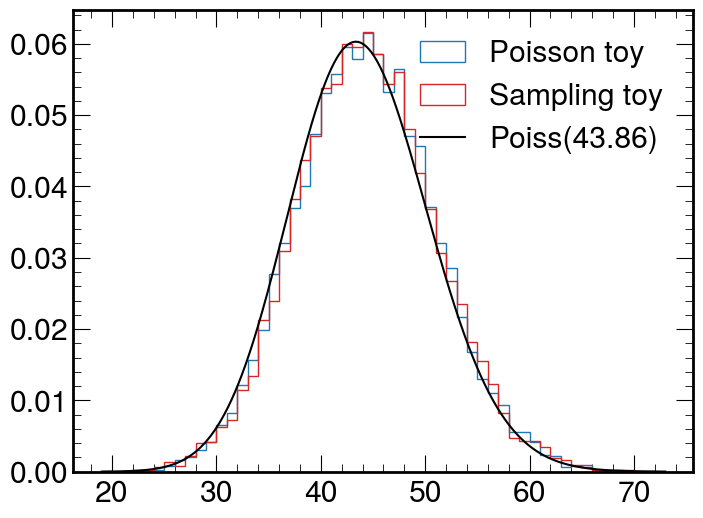

In [53]:
for i in range(len(asimov["CMS_hgg_mass"])):
    fig = plt.figure(figsize=(8,6))
    h, b, _ = plt.hist(hist_poisson_[:,i], bins=np.arange(min(hist_poisson_[:,i]), max(hist_poisson_[:,i])), color='tab:blue', density=True, histtype='step', lw=2, label='Poisson toy')
    h, b, _ = plt.hist(toys[:,i], bins=np.arange(min(hist_poisson_[:,i]), max(hist_poisson_[:,i])), color='tab:red', density=True, histtype='step', lw=2, label='Sampling toy')
    x = np.arange(b[0],b[len(b)-1])
    pmf = poisson.pmf(x, asimov["_weight_"][i])
    scaled_pmf=pmf
    spl = CubicSpline(x, scaled_pmf) ## We are using a spline to represent the Poisson just for visualisation, a Poisson distribution is defined only for discrete values
    x = np.linspace(b[0],b[len(b)-1],1000)
    plt.plot(x, spl(x), color='black', label='Poiss('+str(round(asimov["_weight_"][i],2))+')')
    plt.legend()
    plt.show()
#     break